In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.dates import DateFormatter
import numpy as np
import glob
import matplotlib as mpl
import netCDF4 as nc
from shapely.geometry import Polygon, LineString, Point
import xarray as xr
import cartopy.crs as ccrs
import matplotlib.pyplot as plt
import os
import cartopy.feature as cfeature
import xarray as xr
import geopandas as gpd
import contextily as cx
import h5py
import matplotlib.colors as mcolors
from matplotlib.colors import ListedColormap 
import xyzservices.providers as xyz
import geodatasets

In [2]:
def calc_dist_to_ocean(this_lons, this_lats):
    i=2
    x = np.array([-118.7,-117.59,-116.48])-0.1+0.06*i
    y = np.array([34.1,33.4,32.7])-2/3*0.1+2/3*0.06*i
    xnew = np.linspace(x[0],x[2],100)
    ynew = np.interp(xnew, x, y)
    points = []
    for i_point in range(len(xnew)):
        points.append(Point(xnew[i_point],ynew[i_point]))

    lines = LineString(points)
    
    gs = gpd.GeoSeries(lines, crs='EPSG:4326').to_crs(epsg=3310)
    utm = gs.estimate_utm_crs()
    dists = []
    for i in range(len(this_lons)):
        this_gp = gpd.GeoSeries(Point(this_lons[i],this_lats[i]), crs="EPSG:4326")
        dists.append(gs.to_crs(utm).distance(this_gp.to_crs(utm))[0]/1e3)
    return dists

In [5]:

#datapath = '/Users/zhu/Dropbox/Code/Publications/ZEV-adoption-analysis-data/'
datapath = '{path to ZEV-adoption-analysis-data folder}'
oceanshp = gpd.read_file(r datapath+'ne_10m_ocean.shp')
shapefile = gpd.read_file(r datapath+"LA_Merge.shp")
sourcestr = '{contextily api key}'


In [6]:
aqs = pd.read_csv( datapath + 'mda8_o3.csv')

indx = pd.to_datetime(aqs['date']).dt.month == 8
aqs = aqs.loc[indx,:]
aqs['o3_exd_model'] = (aqs['o3']>=70).astype(int)
aqs['o3_exd_obs'] = (aqs['OZONE']>=70).astype(int)
aqs_exd = aqs.groupby(['longitude','latitude'])[['o3_exd_model','o3_exd_obs']].agg('sum').reset_index()
aqs_exd = gpd.GeoDataFrame(
        aqs_exd, geometry=gpd.points_from_xy(aqs_exd['longitude'], aqs_exd['latitude']))
aqs_exd['o3_exd_model'] = aqs_exd['o3_exd_model']/31
aqs_exd['o3_exd_obs'] = aqs_exd['o3_exd_obs']/31

indx = (aqs_exd['longitude']<-117.62) |  (aqs_exd['longitude']>-117.5)
aqs_exd = aqs_exd.loc[indx,:]


In [7]:
aqs_avg = aqs.groupby(['longitude','latitude']).mean().reset_index()
aqs_avg = gpd.GeoDataFrame(
        aqs_avg, geometry=gpd.points_from_xy(aqs_avg['longitude'], aqs_avg['latitude']))


In [9]:
#read population
gdf_loc = gpd.read_file(r'/Users/zhu/Dropbox/Database/Hera/population/regridd_population_la.shp')
#read distance from coastline
gdf_loc.loc[:,'dist'] = calc_dist_to_ocean(gdf_loc['lon'].values, gdf_loc['lat'].values)
gdf_loc.loc[:,'population'] = gdf_loc.loc[:,'population']*1.052799463
#read orignal lon and lat
arrays = {}
#datapath = '/Users/zhu/Dropbox/Database/Hera/cooking_surf_map/'

filenames = ['vocr_daily_wrf_chem_berk_vcp_noI_phot_soa_siloxane_ivoc_nald_t0_4km.mat']
f = h5py.File(datapath + filenames[0])
for k, v in f.items():
    arrays[k] = np.array(v)

lon = arrays['lon']
lat = arrays['lat']

#make land indx
mask_data = pd.DataFrame()
mask_data['coords'] = list(zip(gdf_loc['lon'],gdf_loc['lat']))
mask_data['coords'] = mask_data['coords'].apply(Point)

points = gpd.GeoDataFrame(mask_data, geometry='coords')
mask_data = gpd.tools.sjoin(points, oceanshp, predicate="within", how='left')
land_indx = np.isnan(mask_data['index_right'].values)
gdf_loc.loc[:,'land_indx'] = land_indx

/var/folders/77/pb109gb144179sms3gzb4cfc0000gn/T/ipykernel_54242/693436819.py:24: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:4326

  mask_data = gpd.tools.sjoin(points, oceanshp, predicate="within", how='left')


In [10]:
#each day
recap_days = list(range(1,32))
filenames = ['wrf_chem_berk_vcp_noI_phot_soa_siloxane_ivoc_nald_4km',
             'wrf_chem_berk_vcp_noI_phot_soa_siloxane_ivoc_nald_t5_4km',
             'wrf_chem_berk_vcp_noI_phot_soa_siloxane_ivoc_nald_t6_4km',
             'wrf_chem_berk_vcp_noI_phot_soa_siloxane_ivoc_nald_t9_4km',
             'wrf_chem_berk_vcp_noI_phot_soa_siloxane_ivoc_nald_t7_4km']

gdfs_tot = []
xlim =  [-118.6,-117.1]
ylim = [33.5,34.2] 
for this_day in recap_days:
    mda8_o3_tots = []
    ts_tots = []
    nox_tots = []
    for filename in filenames:
        #for this_day in recap_days:
        output_filename_thisday = datapath + '2021-08-{:02d}-'.format(this_day) + 'mda8o3_' +filename+'.nc'
        #print(output_filename_thisday)
        ds = xr.open_dataset(output_filename_thisday)
        #mda8_o3 = ds['pan']
        mda8_o3 = ds['__xarray_dataarray_variable__']
        mda8_o3_tot = mda8_o3
        mda8_o3_tots.append(mda8_o3_tot)
        
    gdfs = []
    for mda8_o3_tot in mda8_o3_tots:
        o3 = mda8_o3_tot.values
        df_wrf = pd.DataFrame(data={'lon':lon.flatten(), 'lat':lat.flatten(),'o3':o3.flatten()})
        indx = (df_wrf['lon'] >= xlim[0]) & (df_wrf['lon'] <= xlim[1]) & (df_wrf['lat'] >= ylim[0]) & (df_wrf['lat'] <= ylim[1])
        df_wrf = df_wrf.loc[indx,:]
        
        gdf = gdf_loc.copy(deep=True)
        gdf.loc[:,'o3'] = df_wrf.loc[:,'o3'].values
        gdf.loc[:,'day'] = this_day
        gdf.loc[:,'index'] = range(gdf.shape[0])
        gdf = gdf.set_crs('epsg:4326',allow_override=True)
        gdfs.append(gdf)

    gdfs_tot.append(gdfs)
    

In [11]:
# calculate ozone exceedance
#calculate the each O3
gdfs_combs = []

for i in range(len(filenames)):
    gdfs_comb = gpd.GeoDataFrame()
    for i_day in range(len(recap_days)):
        gdfs_comb = pd.concat([gdfs_comb, gdfs_tot[i_day][i]])
    indx = gdfs_comb['o3']<70
    gdfs_comb.loc[indx,'o3_level'] = 0
    indx = (gdfs_comb['o3']>=70) 
    gdfs_comb.loc[indx,'o3_level'] = 1
    gdfs_combs.append(gdfs_comb)

In [12]:
o3_wexds = []
for i in range(len(filenames)):
    o3_exceedance = gdfs_combs[i].groupby(['lon','lat']).sum()['o3_level'].values
    pop = gdfs_combs[i].groupby(['lon','lat']).first()['population'].values

    o3_wexd = np.nansum(o3_exceedance*pop)/np.nansum(pop)
    o3_wexds.append(o3_wexd)

/var/folders/77/pb109gb144179sms3gzb4cfc0000gn/T/ipykernel_54242/1666535097.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=['Full emission','- Onroad gasoline','- Onroad diesel','- Offroad gasoline','- Offroad diesel'],


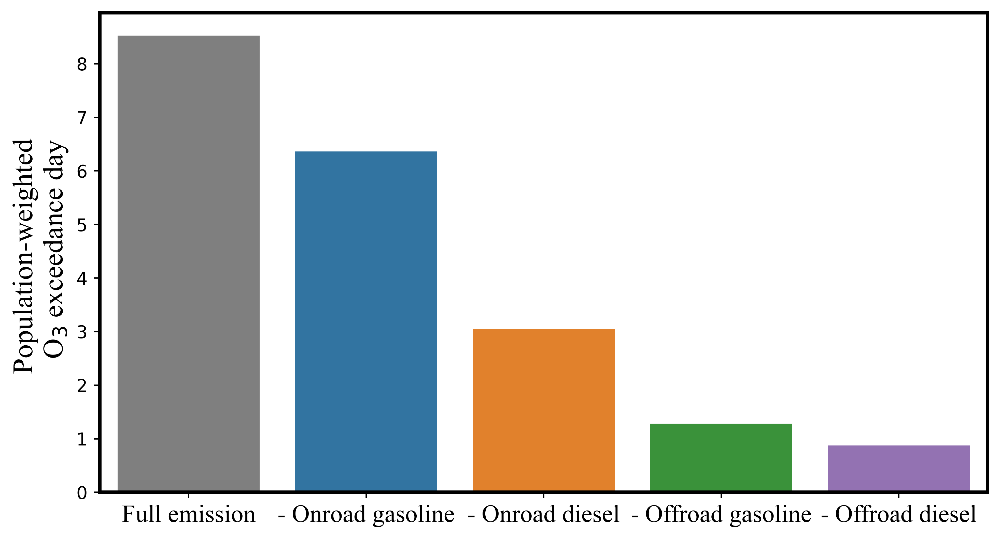

In [13]:
fig, axs = plt.subplots(1,1,figsize=(9,5),dpi=500)
plt.rcParams["font.family"] = "Times New Roman"
colors = ['tab:gray','tab:blue','tab:orange','tab:green','tab:purple']
sns.barplot(x=['Full emission','- Onroad gasoline','- Onroad diesel','- Offroad gasoline','- Offroad diesel'],
            y=o3_wexds,palette=colors,width=0.8)
plt.ylabel('Population-weighted \n O$_3$ exceedance day',**{'fontname':'Times New Roman'},fontsize=16)
plt.xticks(**{'fontname':'Times New Roman'},fontsize=14)
#axs.set_ylabel('Population (million)',fontsize=20,**{'fontname':'Times New Roman'})
for axis in ['top','bottom','left','right']:
        axs.spines[axis].set_linewidth(2)

In [15]:
# calculate the monthly average
gdfs_avg_combs = []
for i in range(len(filenames)):
    month_o3 = []
    for i_day in range(len(recap_days)):
        month_o3.append(gdfs_tot[i_day][i]['o3'])
    gdfs_avg_comb = gdf_loc.copy(deep=True)
    gdfs_avg_comb.loc[:,'o3'] = np.mean(np.array(month_o3),axis=0)
    gdfs_avg_comb = gdfs_avg_comb.set_crs('epsg:4326',allow_override=True)
    
    gdfs_avg_combs.append(gdfs_avg_comb)

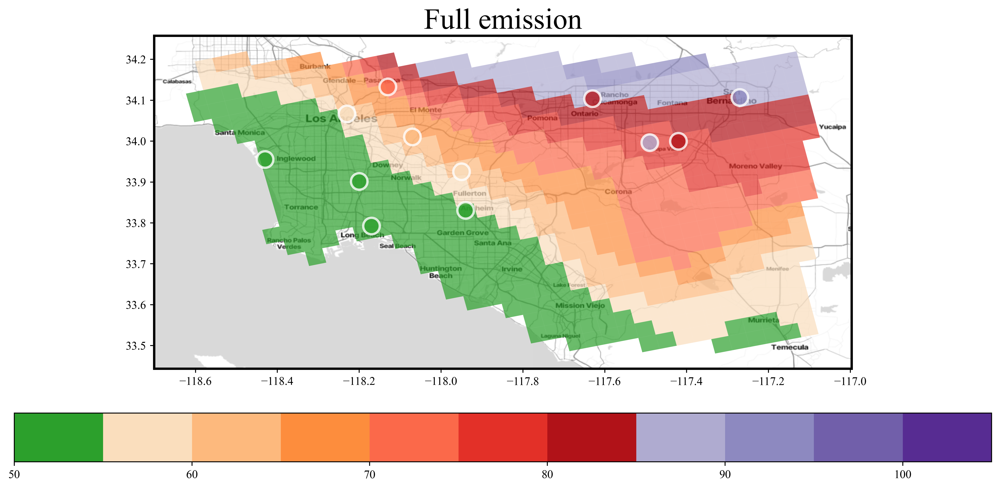

In [16]:
#sourcestr = 'https://tiles.stadiamaps.com/tiles/stamen_terrain/{z}/{x}/{y}{r}.png?api_key=b955e1f6-6afb-42c8-a055-8422ff874f3f'
labels = ['Full emission']
vmax = 105
vmin = 50
nlevels = 12
colors = [mcolors.to_rgb('tab:green')] + sns.color_palette("Oranges", 5)[:3]+sns.color_palette("Reds", 5)[2:] +sns.color_palette("Purples", 6)[2:]

cmap = mcolors.LinearSegmentedColormap.from_list("", colors)
clevel = np.linspace(vmin,vmax,nlevels)
norm = mpl.colors.BoundaryNorm(clevel, ncolors=cmap.N, clip=False)


for i in range(1):
    #fig, axs = plt.subplots(nrows=1,ncols=1,figsize=(8, 3),dpi=500)
    fig, axs = plt.subplots(nrows=1,ncols=1,figsize=(15, 7),dpi=500)
    plt.rcParams["font.family"] = "Times New Roman"
    gdfs_avg_combs[i].loc[land_indx,:].plot(ax=axs, column = 'o3', cmap = cmap,#legend=False,
    #gdfs[2].plot(ax=ax1, column = 'o3', cmap = cmap,
                legend = True, legend_kwds={'shrink': 1,"orientation": "horizontal", "pad": 0.1}, 
                markersize = 10, norm=norm,alpha=0.7)
    aqs_avg.plot(ax=axs, column ='OZONE', cmap = cmap,
            legend = False, edgecolor='w',linewidth=2,
             markersize = 200, norm=norm,alpha=0.8)
    cx.add_basemap(axs, crs=gdf.crs, source=sourcestr)
    for axis in ['top','bottom','left','right']:
        axs.spines[axis].set_linewidth(2)
    axs.set_title(labels[i],fontsize=25,**{'fontname':'Times New Roman'})


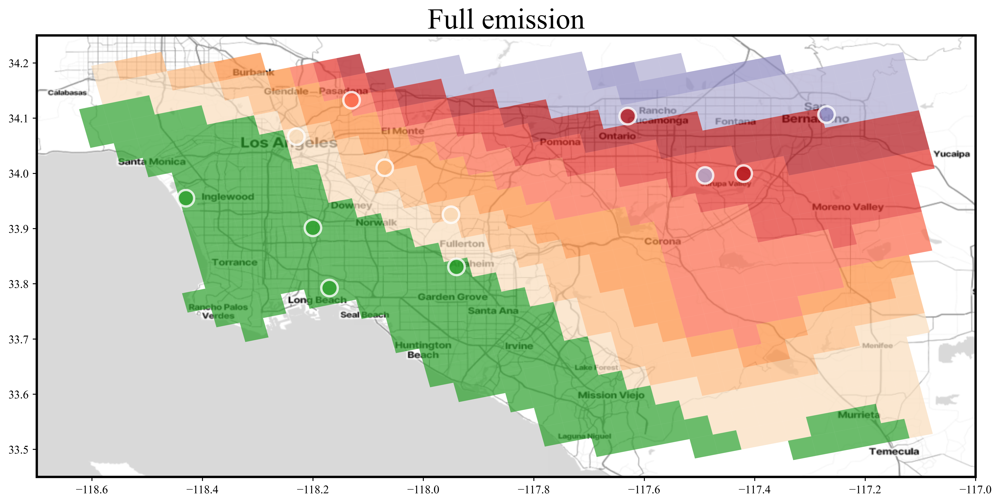

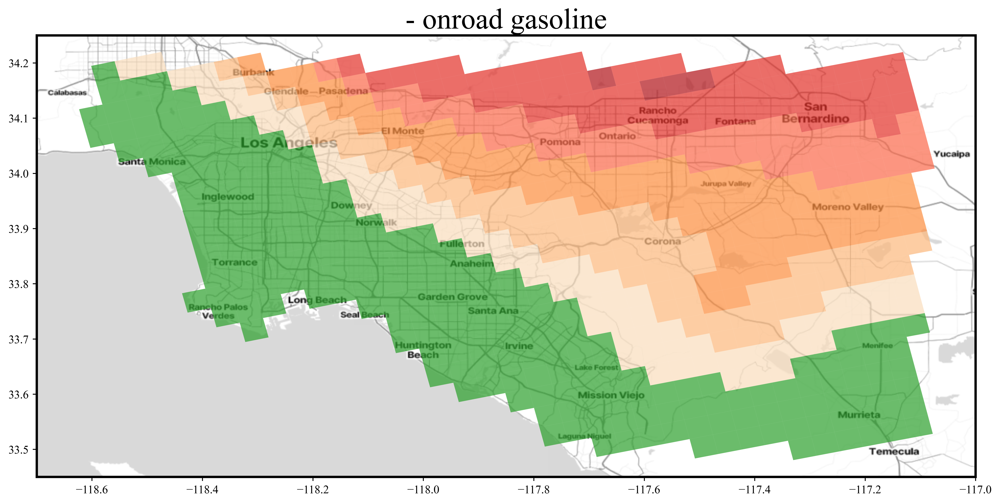

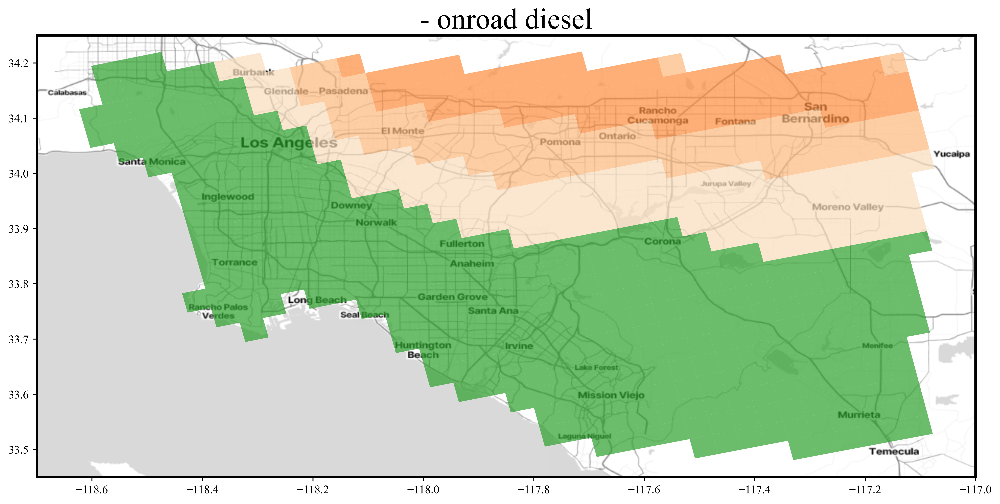

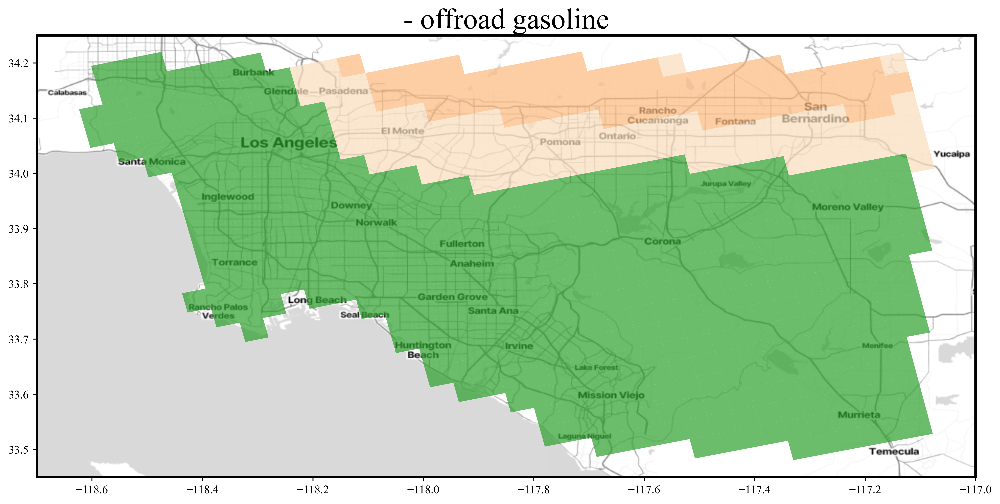

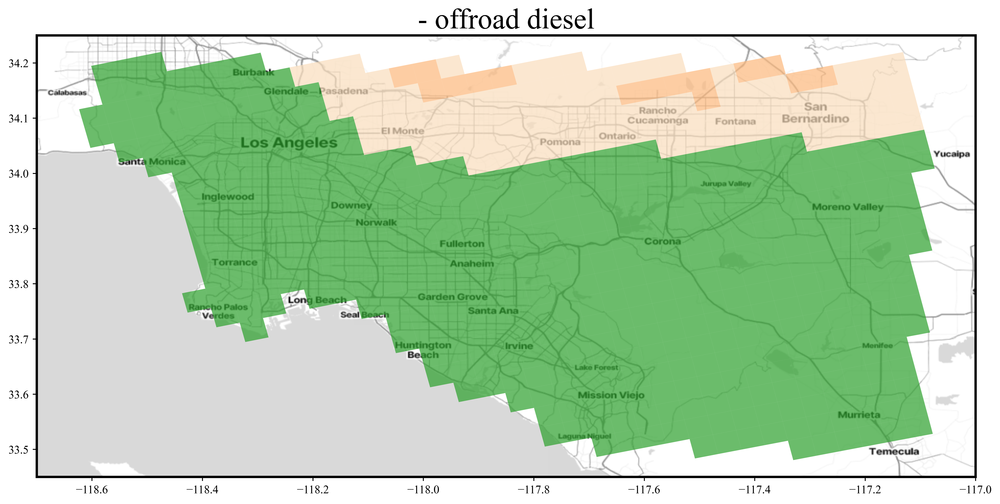

In [18]:
#monthly average


#sourcestr = 'https://tiles.stadiamaps.com/tiles/stamen_terrain/{z}/{x}/{y}{r}.png?api_key=b955e1f6-6afb-42c8-a055-8422ff874f3f'
labels = ['Full emission','- onroad gasoline','- onroad diesel','- offroad gasoline','- offroad diesel']
vmax = 105
vmin = 50
nlevels = 12
colors = [mcolors.to_rgb('tab:green')] + sns.color_palette("Oranges", 5)[:3]+sns.color_palette("Reds", 5)[2:] +sns.color_palette("Purples", 6)[2:]

cmap = mcolors.LinearSegmentedColormap.from_list("", colors)
clevel = np.linspace(vmin,vmax,nlevels)
norm = mpl.colors.BoundaryNorm(clevel, ncolors=cmap.N, clip=False)


for i in range(len(filenames)):
    fig, axs = plt.subplots(nrows=1,ncols=1,figsize=(15, 7),dpi=500)
    plt.rcParams["font.family"] = "Times New Roman"
    gdfs_avg_combs[i].loc[land_indx,:].plot(ax=axs, column = 'o3', cmap = cmap,#legend=False,
    #gdfs[2].plot(ax=ax1, column = 'o3', cmap = cmap,
                legend = False, legend_kwds={'shrink': 1,"orientation": "horizontal", "pad": 0.1}, 
                markersize = 10, norm=norm,alpha=0.7)
    if i == 0:
        aqs_avg.plot(ax=axs, column ='OZONE', cmap = cmap,
            legend = False, edgecolor='w',linewidth=2,
             markersize = 200, norm=norm,alpha=0.8)
        
    #sns.lineplot(x=x,y=y,ax=axs,color='gray',linewidth=2,linestyle='-')
    axs.set_xlim([-118.7,-117])
    axs.set_ylim([33.45, 34.25])
    
    cx.add_basemap(axs, crs=gdf.crs, source=sourcestr)
    axs.set_title(labels[i],fontsize=25,**{'fontname':'Times New Roman'})
    for axis in ['top','bottom','left','right']:
        axs.spines[axis].set_linewidth(2)
    #plt.savefig('/Users/zhu/Dropbox/Conference-Seminar/2024-UCI-job-talk/{}.png'.format(labels[i]))
    